In [1]:
import pandas as pd; pd.options.mode.chained_assignment = None
import numpy as np

# Built In Imports
from datetime import datetime
from glob import glob
import warnings
import IPython
import urllib
import zipfile
import pickle
import shutil
import string
import math
import tqdm
import time
import os
import gc
import re

# Visualization Imports
from matplotlib.colors import ListedColormap
import matplotlib.patches as patches
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from PIL import Image
import matplotlib
import plotly
import PIL
import cv2
from pycocotools.coco import COCO

import plotly.offline as pyo

# Other Imports
from tqdm.notebook import tqdm

from IPython.display import HTML

%cd baseline/mmdetection/
from mmdet.core.visualization.image import *
%cd 

LABEL_COLORS = [px.colors.label_rgb(px.colors.convert_to_RGB_255(x)) for x in sns.color_palette("Spectral", 10)]
LABEL_COLORS_WOUT_NO_FINDING = LABEL_COLORS[:8]+LABEL_COLORS[9:]

/opt/ml/baseline/mmdetection


/opt/conda/envs/competition_effdet/lib/python3.7/site-packages/mmcv/__init__.py:21: UserWarning:

On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.



/opt/ml


Step 2. Convert json to dataframe

In [2]:
coco = COCO('./dataset/train.json')

train_df = pd.DataFrame()

image_ids = []
class_name = []
class_id = []
x_min = []
y_min = []
x_max = []
y_max = []
classes = ["General trash", "Paper", "Paper pack", "Metal", "Glass", 
           "Plastic", "Styrofoam", "Plastic bag", "Battery", "Clothing"]
for image_id in coco.getImgIds():
        
    image_info = coco.loadImgs(image_id)[0]
    ann_ids = coco.getAnnIds(imgIds=image_info['id'])
    anns = coco.loadAnns(ann_ids)
        
    file_name = image_info['file_name']
        
    for ann in anns:
        image_ids.append(file_name)
        class_name.append(classes[ann['category_id']])
        class_id.append(ann['category_id'])
        x_min.append(float(ann['bbox'][0]))
        y_min.append(float(ann['bbox'][1]))
        x_max.append(float(ann['bbox'][0]) + float(ann['bbox'][2]))
        y_max.append(float(ann['bbox'][1]) + float(ann['bbox'][3]))

train_df['image_id'] = image_ids
train_df['class_name'] = class_name
train_df['class_id'] = class_id
train_df['x_min'] = x_min
train_df['y_min'] = y_min
train_df['x_max'] = x_max
train_df['y_max'] = y_max

loading annotations into memory...
Done (t=0.29s)
creating index...
index created!


In [3]:
train_df.head()

,image_id,class_name,class_id,x_min,y_min,x_max,y_max
0,train/0000.jpg,General trash,0,197.6,193.7,745.4,663.4
1,train/0001.jpg,Metal,3,0.0,407.4,57.6,588.0
2,train/0001.jpg,Plastic bag,7,0.0,455.6,144.6,637.2
3,train/0001.jpg,Glass,4,722.3,313.4,996.6,565.3
4,train/0001.jpg,Plastic,5,353.2,671.0,586.9,774.4


# Step 3. EDA

### Annotation Per Images

: 한 이미지에 몇 개의 Bounding box가 있는지, 그 분포를 나타낸 결과입니다.

In [4]:
fig = px.histogram(train_df.image_id.value_counts(), 
                   log_y=True, color_discrete_sequence=['indianred'], opacity=0.7,
                   labels={"value":"Number of Annotations Per Image"},
                   title="<b>DISTRIBUTION OF # OF ANNOTATIONS PER IMAGE   "
                         "<i><sub>(Log Scale for Y-Axis)</sub></i></b>",
                   )
fig.update_layout(showlegend=False,
                  yaxis_title="<b>Number of Unique Images</b>",
                  xaxis_title="<b>Count of All Object Annotations</b>",)
# fig.show()

HTML(fig.to_html())

### Unique Class Per Image

: 한 이미지의 몇 개의 unique한 class가 있는지, 그 분포를 나타낸 결과입니다.

In [5]:
fig = px.histogram(train_df.groupby('image_id')["class_id"].unique().apply(lambda x: len(x)), 
             log_y=True, color_discrete_sequence=['skyblue'], opacity=0.7,
             labels={"value":"Number of Unique class"},
             title="<b>DISTRIBUTION OF # OF Unique Class PER IMAGE   "
                   "<i><sub>(Log Scale for Y-Axis)</sub></i></b>",
                   )
fig.update_layout(showlegend=False,
                  xaxis_title="<b>Number of Unique CLASS</b>",
                  yaxis_title="<b>Count of Unique IMAGE</b>",)
# fig.show()

HTML(fig.to_html())

### Annotations Per Class

: 각 Class 당 몇 개의 Annotation, 즉 bbox가 있는지, 그 분포를 나타낸 결과입니다.

In [6]:
fig = px.bar(train_df.class_name.value_counts().sort_index(), 
             color=train_df.class_name.value_counts().sort_index().index, opacity=0.85,
             color_discrete_sequence=LABEL_COLORS, log_y=True,
             labels={"y":"Annotations Per Class", "x":""},
             title="<b>Annotations Per Class</b>",)
fig.update_layout(legend_title=None,
                  xaxis_title="",
                  yaxis_title="<b>Annotations Per Class</b>")

# fig.show()

HTML(fig.to_html())

### Object heatmap

: 이미지에서 bbox가 주로 어디에 위치하는지를 알아보기 위한 코드입니다.

  0%|          | 0/23144 [00:00<?, ?it/s]

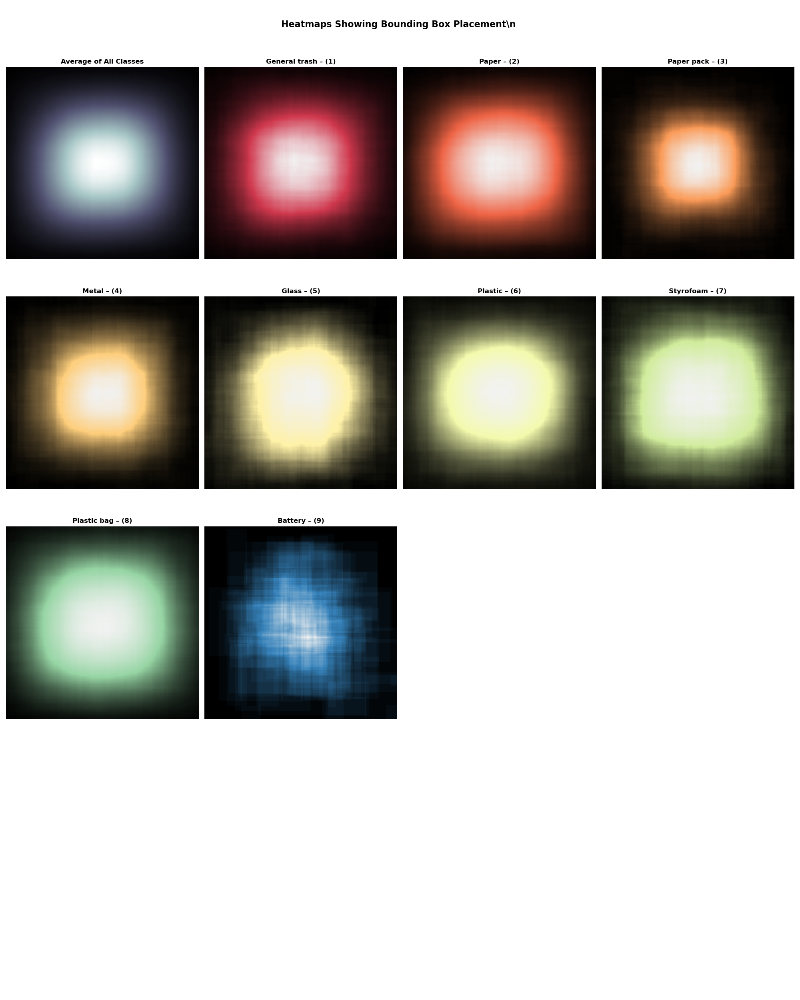

In [50]:
bbox_df = pd.DataFrame()
bbox_df['image_id'] = train_df['image_id'].values
bbox_df['class_id'] = train_df['class_id'].values
bbox_df['class_name'] = train_df['class_name'].values
bbox_df['x_min'] = train_df['x_min'].values / 1024
bbox_df['x_max'] = train_df['x_max'].values / 1024
bbox_df['y_min'] = train_df['y_min'].values / 1024
bbox_df['y_max'] = train_df['y_max'].values / 1024
bbox_df['frac_x_min'] = train_df['x_min'].values / 1024
bbox_df['frac_x_max'] = train_df['x_max'].values / 1024
bbox_df['frac_y_min'] = train_df['y_min'].values / 1024
bbox_df['frac_y_max'] = train_df['y_max'].values / 1024

ave_src_img_height = 1024
ave_src_img_width = 1024

# DEFAULT
HEATMAP_SIZE = (ave_src_img_height, ave_src_img_width, 14)

# Initialize
heatmap = np.zeros((HEATMAP_SIZE), dtype=np.int16)
bbox_np = bbox_df[["class_id", "frac_x_min", "frac_x_max", "frac_y_min", "frac_y_max"]].to_numpy()
bbox_np[:, 1:3] *= ave_src_img_width
bbox_np[:, 3:5] *= ave_src_img_height
bbox_np = np.floor(bbox_np).astype(np.int16)

# Color map stuff
custom_cmaps = [
    matplotlib.colors.LinearSegmentedColormap.from_list(
        colors=[(0.,0.,0.), c, (0.95,0.95,0.95)], 
        name=f"custom_{i}") for i,c in enumerate(sns.color_palette("Spectral", 10))
]
custom_cmaps.pop(8) # Remove No-Finding

for row in tqdm(bbox_np, total=bbox_np.shape[0]):
    heatmap[row[3]:row[4]+1, row[1]:row[2]+1, row[0]] += 1
    
fig = plt.figure(figsize=(20,25))
plt.suptitle("Heatmaps Showing Bounding Box Placement\\n ", fontweight="bold", fontsize=16)
for i in range(10):
    plt.subplot(4, 4, i+1)
    if i==0:
        plt.imshow(heatmap.mean(axis=-1), cmap="bone")
        plt.title(f"Average of All Classes", fontweight="bold")
    else:
        plt.imshow(heatmap[:, :, i-1], cmap=custom_cmaps[i-1])
        plt.title(f"{classes[i-1]} – ({i})", fontweight="bold")
        
    plt.axis(False)
fig.tight_layout(rect=[0, 0.03, 1, 0.97])
plt.show()

### Distribution of bbox area

: 각 Class 별 bounding box의 크기 분포입니다.

In [8]:
# Update bbox dataframe to make this easier
bbox_df["frac_bbox_area"] = (bbox_df["frac_x_max"]-bbox_df["frac_x_min"])*(bbox_df["frac_y_max"]-bbox_df["frac_y_min"])
# bbox_df["class_id_as_str"] = bbox_df["class_id"].map(classes)
display(bbox_df.head())

fig = px.box(bbox_df.sort_values(by="class_name"), x="class_name", y="frac_bbox_area", color="class_name", 
             color_discrete_sequence=LABEL_COLORS_WOUT_NO_FINDING, notched=True,
             labels={"class_name":"Class Name", "frac_bbox_area":"BBox Area (%)"},
             title="<b>DISTRIBUTION OF BBOX AREAS AS % OF SOURCE IMAGE AREA   " 
                   "<i><sub>(Some Upper Outliers Excluded For Better Visualization)</sub></i></b>")

fig.update_layout(showlegend=True,
                  yaxis_range=[-0.025,0.4],
                  legend_title_text=None,
                  xaxis_title="",
                  yaxis_title="<b>Bounding Box Area %</b>",)
# fig.show()

HTML(fig.to_html())

,class_id,class_name,x_min,x_max,y_min,y_max,frac_x_min,frac_x_max,frac_y_min,frac_y_max,frac_bbox_area
0,0,General trash,0.192969,0.727930,0.189160,0.647852,0.192969,0.727930,0.189160,0.647852,0.245382
1,3,Metal,0.000000,0.056250,0.397852,0.574219,0.000000,0.056250,0.397852,0.574219,0.009921
2,7,Plastic bag,0.000000,0.141211,0.444922,0.622266,0.000000,0.141211,0.444922,0.622266,0.025043
3,4,Glass,0.705371,0.973242,0.306055,0.552051,0.705371,0.973242,0.306055,0.552051,0.065895
4,5,Plastic,0.344922,0.573145,0.655273,0.756250,0.344922,0.573145,0.655273,0.756250,0.023045


### Aspect Ratio for bounding boxes by class

: 각 Class 별 bounding box의 aspect ratio 값입니다. 이를 활용하여 anchor generator의 aspect ratio 비율을 조절해볼 수 있습니다.

In [9]:
# Aspect Ratio is Calculated as Width/Height
bbox_df["aspect_ratio"] = (bbox_df["x_max"]-bbox_df["x_min"])/(bbox_df["y_max"]-bbox_df["y_min"])

# Display average means for each class_id so we can examine the newly created Aspect Ratio Column
display(bbox_df.groupby("class_id").mean())

# Generate the bar plot
fig = px.bar(x=classes, y=bbox_df.groupby("class_id").mean()["aspect_ratio"], 
             color=classes, opacity=0.85,
             color_discrete_sequence=LABEL_COLORS_WOUT_NO_FINDING, 
             labels={"x":"Class Name", "y":"Aspect Ratio (W/H)"},
             title="<b>Aspect Ratios For Bounding Boxes By Class</b>",)
fig.update_layout(
                  yaxis_title="<b>Aspect Ratio (W/H)</b>",
                  xaxis_title=None,
                  legend_title_text=None)
fig.add_hline(y=1, line_width=2, line_dash="dot", 
              annotation_font_size=10, 
              annotation_text="<b>SQUARE ASPECT RATIO</b>", 
              annotation_position="bottom left", 
              annotation_font_color="black")
fig.add_hrect(y0=0, y1=0.5, line_width=0, fillcolor="red", opacity=0.125,
              annotation_text="<b>>2:1 VERTICAL RECTANGLE REGION</b>", 
              annotation_position="bottom right", 
              annotation_font_size=10,
              annotation_font_color="red")
fig.add_hrect(y0=2, y1=3.5, line_width=0, fillcolor="green", opacity=0.04,
              annotation_text="<b>>2:1 HORIZONTAL RECTANGLE REGION</b>", 
              annotation_position="top right", 
              annotation_font_size=10,
              annotation_font_color="green")
# fig.show()

HTML(fig.to_html())

,x_min,x_max,y_min,y_max,frac_x_min,frac_x_max,frac_y_min,frac_y_max,frac_bbox_area,aspect_ratio
class_id,,,,,,,,,,
0,0.383549,0.604483,0.394808,0.605228,0.383549,0.604483,0.394808,0.605228,0.075207,1.433186
1,0.375895,0.633562,0.375408,0.606554,0.375895,0.633562,0.375408,0.606554,0.087780,1.391648
2,0.378863,0.618020,0.408042,0.622968,0.378863,0.618020,0.408042,0.622968,0.072590,1.296333
3,0.387037,0.632183,0.368833,0.620011,0.387037,0.632183,0.368833,0.620011,0.087399,1.239462
4,0.401057,0.602315,0.388950,0.654449,0.401057,0.602315,0.388950,0.654449,0.066126,1.043987
5,0.391260,0.625025,0.386217,0.611491,0.391260,0.625025,0.386217,0.611491,0.077239,1.288092
6,0.352261,0.644397,0.368552,0.614946,0.352261,0.644397,0.368552,0.614946,0.093069,1.474087
7,0.368910,0.637833,0.341409,0.635559,0.368910,0.637833,0.341409,0.635559,0.105245,1.106761
8,0.401370,0.624880,0.422020,0.631976,0.401370,0.624880,0.422020,0.631976,0.048075,1.428327


In [10]:
ratio_list = [1.433, 1.391, 1.296, 1.239, 1.043, 1.288, 1.474, 1.106, 1.428, 1.228]
class_count = [3966, 6352, 897, 936, 982, 2943, 1263, 5178, 159, 468]
sum_list = [ratio_list[i]*class_count[i] for i in range(len(ratio_list))]
sum(sum_list)/sum(class_count)  # bbox 평균 비율

1.2982294331144142

In [16]:
bbox_df[['frac_bbox_area', 'aspect_ratio']].corr()  # bbox의 크기와 비율 간에는 상관관계 x 

,frac_bbox_area,aspect_ratio
frac_bbox_area,1.000000,-0.078443
aspect_ratio,-0.078443,1.000000


In [35]:
bbox_df.aspect_ratio.describe() # 중간값은 1인데 평균은 1.3 -> 가로가 훨씬 긴 것들이 꽤 있다는 것으로 해석
                                # -> 0.8 1.3 1.6에서 조금더 ratio 폭을 넓힘 

count   23144.00000
mean        1.29871
std         1.16679
min         0.05539
25%         0.69115
50%         1.04752
75%         1.53731
max        27.28571
Name: aspect_ratio, dtype: float64

- anchor box ratio -> 0.8 1.3 1.6 -> 0.5 1.3 2.5

- 가장 평균이 낮은 것보다 0.2정도 낮게, 평균, 가장 평균이 높은 것보다 0.2정도 높게 설정

In [19]:
import json
import numpy as np
import pandas as pd

annotation = 'dataset/train.json'

with open(annotation) as f:
    data = json.load(f)


In [20]:
data_df = pd.DataFrame(data['annotations'])
pd.options.display.float_format = '{:.5f}'.format
data_df.area.describe()

count     23144.00000
mean      92863.95784
std      135979.14786
min           0.56000
25%        9997.67000
50%       38938.47000
75%      119122.47500
max     1048371.21000
Name: area, dtype: float64

In [45]:
data_df[data_df['area']<=1000 ]  # 직접 시각화하여 이미지 확인해보면, 1000이하 크기는 불필요할 정도로 굉장히작고
                                 # 작은 bbox중에 noise의 비율이 높았다 -> 1000이하의 bbox는 ann에서 제거

,image_id,category_id,area,bbox,iscrowd,id
21,5,0,747.25000,"[329.8, 203.2, 42.7, 17.5]",0,21
182,42,0,789.37000,"[750.7, 479.8, 40.9, 19.3]",0,182
241,51,1,868.56000,"[156.2, 222.5, 23.1, 37.6]",0,241
264,55,0,658.32000,"[530.8, 877.7, 21.1, 31.2]",0,264
460,103,1,550.56000,"[1011.3, 341.3, 12.4, 44.4]",0,460
...,...,...,...,...,...,...
22817,4813,0,879.45000,"[801.0, 1004.4, 45.1, 19.5]",0,22817
22829,4814,0,845.46000,"[452.6, 611.6, 46.2, 18.3]",0,22829
22878,4824,5,893.04000,"[1005.4, 2.8, 18.3, 48.8]",0,22878
22975,4841,0,809.58000,"[512.3, 684.7, 39.3, 20.6]",0,22975


In [83]:
bbox_df["aspect_ratio"] = (bbox_df["x_max"]-bbox_df["x_min"])/(bbox_df["y_max"]-bbox_df["y_min"])
bbox_df[bbox_df['aspect_ratio']>6]
bbox_df[bbox_df['aspect_ratio']<0.17] 
# 직접 시각화하여 이미지 확인해보면, ratio 6이상의bbox중에 noise의 비율이 높았다 
# -> ratio 6이상의 bbox는 ann에서 제거
# 직접 시각화하여 이미지 확인해보면, ratio 0.17이하의bbox중에 noise의 비율이 높았다 
# -> ratio 0.17 이하의 bbox는 ann에서 제거
# -->> 가로, 세로 중, 한 쪽이 다른 쪽의 6배 이상 큰 경우는 noise로 분류

988.09856 357.79584


In [40]:
data_df.groupby('image_id')['bbox'].count().describe()

count   4883.00000
mean       4.73971
std        6.35515
min        1.00000
25%        1.00000
50%        2.00000
75%        6.00000
max       71.00000
Name: bbox, dtype: float64

In [25]:
############################

In [27]:
display(train_df.head())
bbox_df.head()

,image_id,class_name,class_id,x_min,y_min,x_max,y_max
0,train/0000.jpg,General trash,0,197.6,193.7,745.4,663.4
1,train/0001.jpg,Metal,3,0.0,407.4,57.6,588.0
2,train/0001.jpg,Plastic bag,7,0.0,455.6,144.6,637.2
3,train/0001.jpg,Glass,4,722.3,313.4,996.6,565.3
4,train/0001.jpg,Plastic,5,353.2,671.0,586.9,774.4


,class_id,class_name,x_min,x_max,y_min,y_max,frac_x_min,frac_x_max,frac_y_min,frac_y_max,frac_bbox_area,aspect_ratio
0,0,General trash,0.192969,0.727930,0.189160,0.647852,0.192969,0.727930,0.189160,0.647852,0.245382,1.166276
1,3,Metal,0.000000,0.056250,0.397852,0.574219,0.000000,0.056250,0.397852,0.574219,0.009921,0.318937
2,7,Plastic bag,0.000000,0.141211,0.444922,0.622266,0.000000,0.141211,0.444922,0.622266,0.025043,0.796256
3,4,Glass,0.705371,0.973242,0.306055,0.552051,0.705371,0.973242,0.306055,0.552051,0.065895,1.088924
4,5,Plastic,0.344922,0.573145,0.655273,0.756250,0.344922,0.573145,0.655273,0.756250,0.023045,2.260155


### bbox 중심점 좌표 시각화

In [75]:
bbox_df2 = bbox_df.copy()
bbox_df2['x_center'] = ((bbox_df2['x_min'] + bbox_df2['x_max']) /  2) * 1024
bbox_df2['y_center'] = ((bbox_df2['y_min'] + bbox_df2['y_max']) /  2) * 1024
bbox_df2.head()

,class_id,class_name,x_min,x_max,y_min,y_max,frac_x_min,frac_x_max,frac_y_min,frac_y_max,frac_bbox_area,aspect_ratio,x_center,y_center
0,0,General trash,0.192969,0.727930,0.189160,0.647852,0.192969,0.727930,0.189160,0.647852,0.245382,1.166276,471.50,428.55
1,3,Metal,0.000000,0.056250,0.397852,0.574219,0.000000,0.056250,0.397852,0.574219,0.009921,0.318937,28.80,497.70
2,7,Plastic bag,0.000000,0.141211,0.444922,0.622266,0.000000,0.141211,0.444922,0.622266,0.025043,0.796256,72.30,546.40
3,4,Glass,0.705371,0.973242,0.306055,0.552051,0.705371,0.973242,0.306055,0.552051,0.065895,1.088924,859.45,439.35
4,5,Plastic,0.344922,0.573145,0.655273,0.756250,0.344922,0.573145,0.655273,0.756250,0.023045,2.260155,470.05,722.70


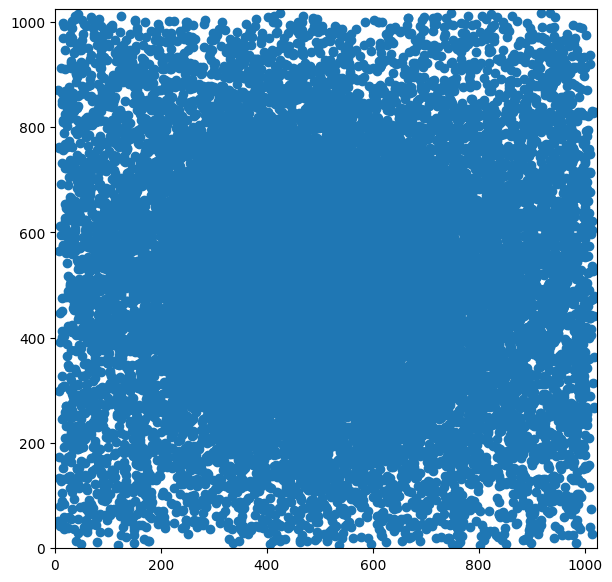

In [79]:
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(111)
ax.scatter(x=bbox_df2.x_center, y=bbox_df2.y_center)
ax.set_xlim(0,1024)
ax.set_ylim(0,1024)

plt.show()

In [85]:
class_list = bbox_df2.class_name.unique().tolist()
x_center_dict = {key:[] for key in class_list}
y_center_dict = {key:[] for key in class_list}

for i, row in bbox_df2.iterrows():
    box_class = row['class_name']
    x_center_dict[box_class].append(row['x_center'])
    y_center_dict[box_class].append(row['y_center'])

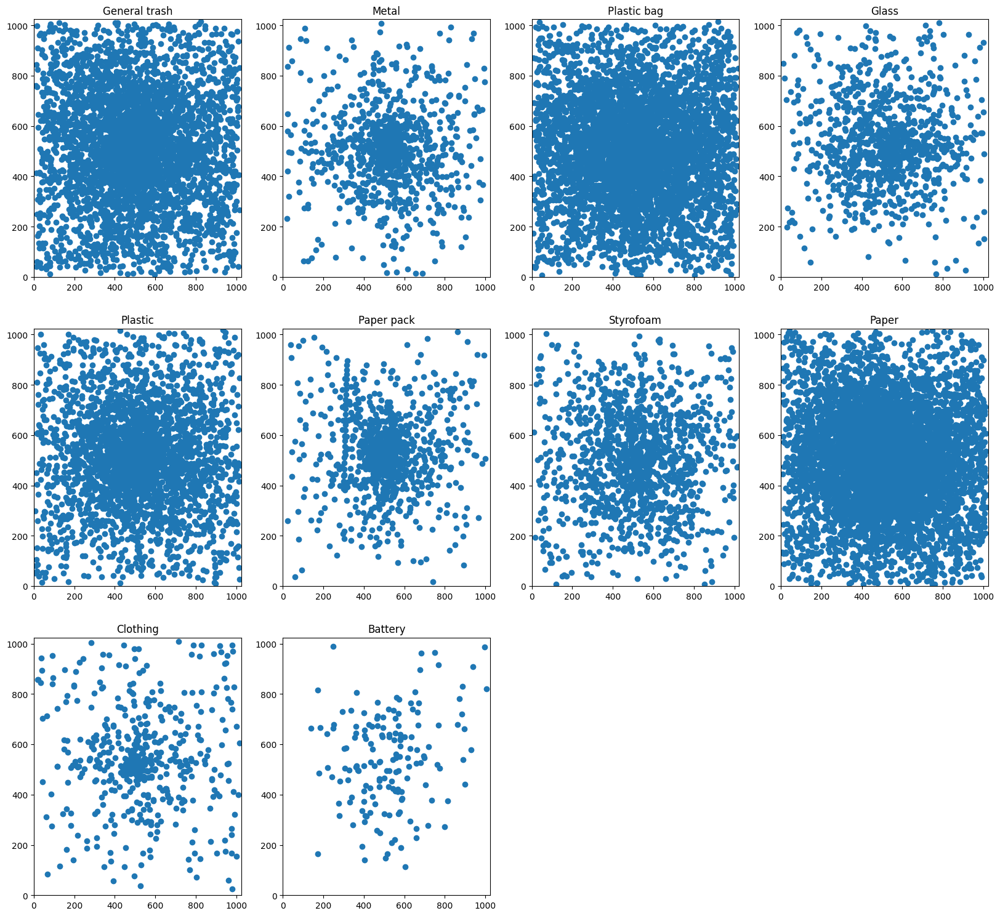

In [95]:
fig = plt.figure(figsize=(20,25))
for i, cls in enumerate(class_list):
    plt.subplot(4, 4, i+1)
    plt.scatter(x=x_center_dict[cls], y=y_center_dict[cls])
    plt.title(cls)
    plt.xlim(0,1024)
    plt.ylim(0,1024)

### Train set 시각화

loading annotations into memory...
Done (t=0.10s)
creating index...
index created!
[{'image_id': 118, 'category_id': 1, 'area': 1573.25, 'bbox': [925.8, 779.4, 77.5, 20.3], 'iscrowd': 0, 'id': 550}, {'image_id': 118, 'category_id': 7, 'area': 6904.65, 'bbox': [737.2, 766.2, 286.5, 24.1], 'iscrowd': 0, 'id': 551}, {'image_id': 118, 'category_id': 1, 'area': 1882.32, 'bbox': [739.6, 766.5, 142.6, 13.2], 'iscrowd': 0, 'id': 552}, {'image_id': 118, 'category_id': 7, 'area': 54067.47, 'bbox': [665.4, 630.1, 358.3, 150.9], 'iscrowd': 0, 'id': 553}, {'image_id': 118, 'category_id': 1, 'area': 4860.4, 'bbox': [688.4, 756.1, 335.2, 14.5], 'iscrowd': 0, 'id': 554}, {'image_id': 118, 'category_id': 1, 'area': 12513.83, 'bbox': [686.4, 728.1, 337.3, 37.1], 'iscrowd': 0, 'id': 555}, {'image_id': 118, 'category_id': 7, 'area': 47884.05, 'bbox': [694.5, 597.1, 329.1, 145.5], 'iscrowd': 0, 'id': 556}, {'image_id': 118, 'category_id': 7, 'area': 5305.18, 'bbox': [716.5, 572.7, 43.7, 121.4], 'iscrowd': 

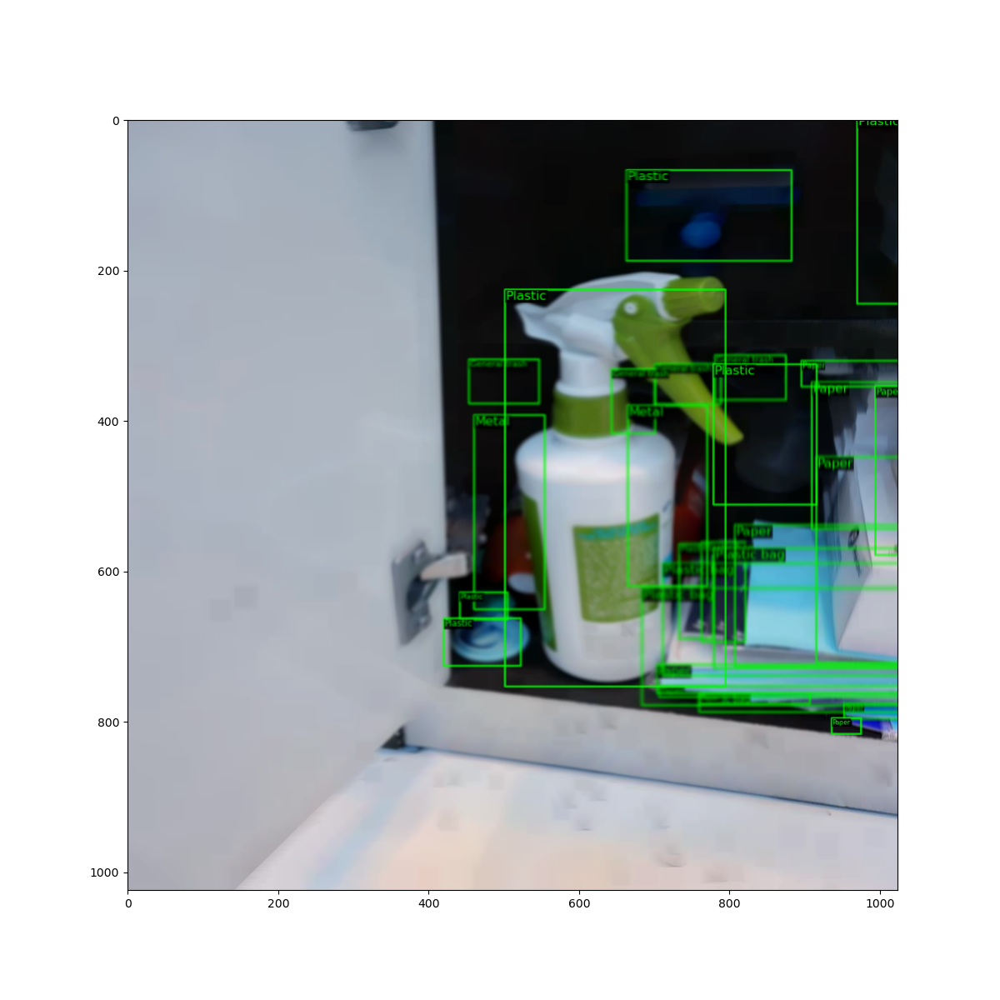

In [84]:
%matplotlib widget
annotation_path = './dataset/train.json'
data_dir = './dataset'
coco_annotation = COCO(annotation_file=annotation_path)
plt.clf()

classes = ["General trash", "Paper", "Paper pack", "Metal", "Glass", 
           "Plastic", "Styrofoam", "Plastic bag", "Battery", "Clothing"]

# Pick one image.
img_id = 118
img_info = coco_annotation.loadImgs([img_id])[0]
img_file_name = img_info["file_name"]
img_url = img_info["coco_url"]
# print(f"Image ID: {img_id}, File Name: {img_file_name}, Image URL: {img_url}")

# Get all the annotations for the specified image.
ann_ids = coco_annotation.getAnnIds(imgIds=[img_id], iscrowd=None)
anns = coco_annotation.loadAnns(ann_ids)
# print(f"Annotations for Image ID {img_id}:")
print(anns)

img = cv2.imread(os.path.join(data_dir, img_file_name))


for ann in anns:
    c = (np.random.random((1, 3))*0.6+0.4).tolist()[0]
    [bbox_x, bbox_y, bbox_w, bbox_h] = ann['bbox']
    bbox_list = [bbox_x, bbox_y, bbox_x+bbox_w, bbox_y+bbox_h]
    bbox = np.array(bbox_list)
    bbox = np.expand_dims(bbox, axis=0)
    bbox_class_id = ann['category_id']
    bbox_class_id = np.array(bbox_class_id)
    bbox_class_id = np.expand_dims(bbox_class_id, axis=0)
    img = imshow_det_bboxes(img, bbox, bbox_class_id, class_names=classes,font_size=12, show=False)
plt.figure(figsize=(12,12))
plt.imshow(img)
plt.show()

### Test set 시각화

In [58]:
test_image_file_name1 = os.listdir('./dataset/test')
test_image_file_name = []
for file in test_image_file_name1:
    if file.split('/')[-1][0] != '.':
        test_image_file_name.append(file)
test_image_path_list = []
for file in test_image_file_name:
    test_image_path = os.path.join('./dataset/test', file)
    test_image_path_list.append(test_image_path)
test_image_path_list[0]

'./dataset/test/1277.jpg'

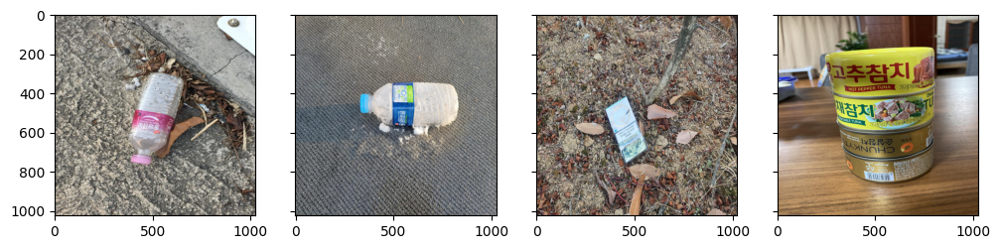

In [96]:
fig, axes = plt.subplots(1, 4, sharex=True, sharey=True, figsize=(12, 6))

for i, path in enumerate(test_image_path_list[100:104]):
    img = np.array(Image.open(path))
    axes[i].imshow(img)
plt.show()

### pseudo labeling

In [1]:
import pandas as pd
import numpy as np

pseudo_df = pd.read_csv('output_best.csv')
pseudo_df.head()

,PredictionString,image_id
0,7 0.9920914173126221 208.55441284179688 48.766...,test/0000.jpg
1,5 0.9239843487739563 125.11742401123047 2.8685...,test/0001.jpg
2,1 0.9707459211349487 77.59071350097656 270.659...,test/0002.jpg
3,9 0.8658463954925537 149.75205993652344 253.91...,test/0003.jpg
4,1 0.81441330909729 191.17074584960938 237.0220...,test/0004.jpg


In [2]:
score_list = []
for i, row in pseudo_df.iterrows():
    pred_str = row['PredictionString']
    pred_str_list = pred_str.split()
    for j in range(len(pred_str_list)):
        if j%6==1:
            score_list.append(pred_str_list[j])

In [3]:
score_list = list(map(float, score_list))
np.mean(score_list)

0.04261586471814572

In [28]:
len(score_list)

491649

In [5]:
filtered_score_list = [i for i in score_list if i > 0.6]
len(filtered_score_list)

10911

In [ ]:
## threshold 0.5로 설정